In [1]:
import ultralytics
from ultralytics import YOLO

In [2]:
import warnings
warnings.filterwarnings('ignore')
warnings.simplefilter('ignore')
import torch    
import cv2
import numpy as np
import matplotlib.pyplot as plt
import requests
import torchvision.transforms as transforms
from PIL import Image
import io
import os

In [3]:
plt.rcParams["figure.figsize"] = [3.0, 3.0]

# Just import these 2 modules

In [4]:
from yolo_cam.eigen_cam import EigenCAM
from yolo_cam.utils.image import show_cam_on_image, scale_cam_image

# For the object detection model

In [5]:
model_ori = YOLO('E:\\code\\ultralytics1\\yolov8_co\\yolov8n.pt')
model_se = YOLO('E:\\code\\ultralytics1\\yolov8_co\\yolov8n.pt')
model_cbam = YOLO('E:\\code\\ultralytics1\\yolov8_co\\cbam_best.pt')
model_eca = YOLO('E:\\code\\ultralytics1\\yolov8_co\\dw_best.pt')
model_dw = YOLO('E:\\code\\ultralytics1\\yolov8_co\\dw_best.pt')

In [6]:
path = 'E:\\code\\ultralytics1\\images\\coco_airplane_1.jpg'

In [7]:
target_layers_ori =[model_ori.model.model[15],model_ori.model.model[18],model_ori.model.model[21]]
target_layers_se =[model_se.model.model[15],model_se.model.model[18],model_se.model.model[21]]
target_layers_cbam =[model_cbam.model.model[15],model_cbam.model.model[18],model_cbam.model.model[21]]
target_layers_eca =[model_eca.model.model[15],model_eca.model.model[18],model_eca.model.model[21]]
target_layers_dw =[model_dw.model.model[15],model_dw.model.model[18],model_dw.model.model[21]]
# print(target_layers)

In [8]:
def grad(images):
    #ORI
    cam_ori = EigenCAM(model_ori, target_layers_ori,task='od')
    grayscale_cam_ori = cam_ori(rgb_img)[0, :, :]
    grayscale_cam_ori = cam_ori(rgb_img)[0, :, :]
    cam_image_ori = show_cam_on_image(img, grayscale_cam_ori, use_rgb=True)
    images.append(cam_image_ori)
    #SE
    cam_se = EigenCAM(model_se, target_layers_se,task='od')
    grayscale_cam_se = cam_se(rgb_img)[0, :, :]
    grayscale_cam_se = cam_se(rgb_img)[0, :, :]
    cam_image_se = show_cam_on_image(img, grayscale_cam_se, use_rgb=True)
    images.append(cam_image_se)
    #CBAM
    cam_cbam = EigenCAM(model_cbam, target_layers_cbam,task='od')
    grayscale_cam_cbam = cam_cbam(rgb_img)[0, :, :]
    grayscale_cam_cbam = cam_cbam(rgb_img)[0, :, :]
    cam_image_cbam = show_cam_on_image(img, grayscale_cam_cbam, use_rgb=True)
    images.append(cam_image_cbam)
    #ECA
    cam_eca = EigenCAM(model_eca, target_layers_eca,task='od')
    grayscale_cam_eca = cam_eca(rgb_img)[0, :, :]
    grayscale_cam_eca = cam_eca(rgb_img)[0, :, :]
    cam_image_eca = show_cam_on_image(img, grayscale_cam_eca, use_rgb=True)
    images.append(cam_image_eca)
    #DW
    cam_dw = EigenCAM(model_dw, target_layers_dw,task='od')
    grayscale_cam_dw = cam_dw(rgb_img)[0, :, :]
    grayscale_cam_dw = cam_dw(rgb_img)[0, :, :]
    cam_image_dw = show_cam_on_image(img, grayscale_cam_dw, use_rgb=True)
    images.append(cam_image_dw)

In [9]:
image_folder = 'E:\\code\\ultralytics1\\images'
result_folder= 'E:\\code\\ultralytics1\\result'
image_files = [f for f in os.listdir(image_folder) if f.endswith(('.png', '.jpg', '.jpeg', '.tiff', '.bmp'))]
print(image_files)

['coco_airplane_1.jpg', 'coco_bear_1.jpg', 'coco_car_1.jpg', 'coco_car_2.jpg', 'coco_car_3.jpg', 'coco_person_1.jpg', 'coco_person_2.jpg', 'coco_person_3.jpg', 'coco_person_4.jpg']


In [10]:
titles = ['Origin','YOLOv8', 'SE', 'CBAM', 'ECA', 'LSMA']

In [ ]:
for image_file in image_files:
    image_path = os.path.join(image_folder, image_file)
    images=[]
    images.append(img)
    
    
    grad(images)
    fig, axs = plt.subplots(nrows=1, ncols=6, figsize=(50, 50))
    plt.tight_layout()
    plt.subplots_adjust(hspace=0) 
    # 遍历子图并显示图像
    for ax, title, image in zip(axs, titles, images):
        ax.set_title(title,fontsize=45)
        ax.imshow(image)
        ax.axis('off')  # 关闭坐标轴
    plt.savefig("high_res_plot.png", dpi=300, transparent=True)
    plt.show()


0: 640x640 1 airplane, 9.6ms
Speed: 3.0ms preprocess, 9.6ms inference, 222.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 airplane, 10.0ms
Speed: 2.0ms preprocess, 10.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 airplane, 8.0ms
Speed: 2.0ms preprocess, 8.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 airplane, 10.0ms
Speed: 3.0ms preprocess, 10.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 airplane, 37.0ms
Speed: 4.0ms preprocess, 37.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 airplane, 43.0ms
Speed: 4.0ms preprocess, 43.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 airplane, 37.0ms
Speed: 4.0ms preprocess, 37.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 airplane, 43.0ms
Speed: 3.0ms preprocess, 43.0ms inference, 2.0ms postprocess per image at s

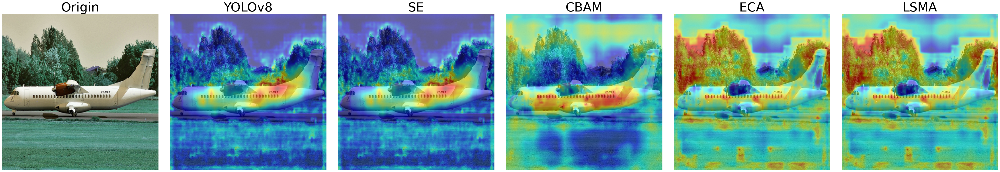


0: 640x640 1 bear, 12.0ms
Speed: 2.0ms preprocess, 12.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 bear, 10.0ms
Speed: 3.0ms preprocess, 10.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 bear, 14.0ms
Speed: 2.0ms preprocess, 14.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 bear, 18.0ms
Speed: 3.0ms preprocess, 18.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 bear, 26.0ms
Speed: 4.0ms preprocess, 26.0ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 bear, 13.0ms
Speed: 3.0ms preprocess, 13.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 bear, 25.0ms
Speed: 3.0ms preprocess, 25.0ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 bear, 13.0ms
Speed: 3.0ms preprocess, 13.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x

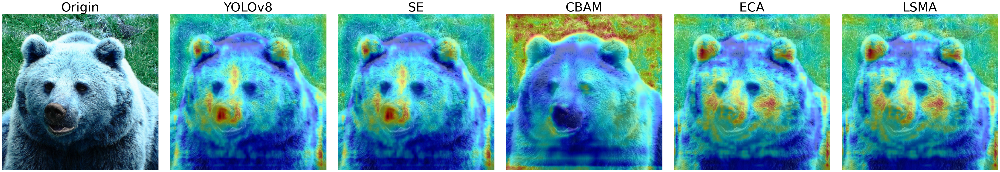


0: 640x640 2 buss, 31.0ms
Speed: 5.0ms preprocess, 31.0ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 2 buss, 41.0ms
Speed: 4.0ms preprocess, 41.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 2 buss, 35.0ms
Speed: 3.0ms preprocess, 35.0ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 2 buss, 45.0ms
Speed: 5.0ms preprocess, 45.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 3 buss, 48.0ms
Speed: 3.0ms preprocess, 48.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 3 buss, 46.0ms
Speed: 4.0ms preprocess, 46.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 2 buss, 47.0ms
Speed: 4.0ms preprocess, 47.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 2 buss, 48.0ms
Speed: 4.0ms preprocess, 48.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x

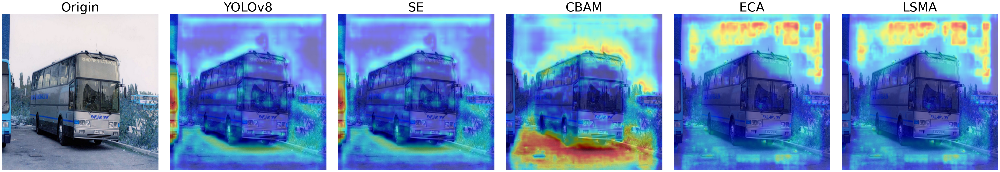


0: 640x640 2 cars, 1 bus, 31.0ms
Speed: 3.0ms preprocess, 31.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 2 cars, 1 bus, 34.0ms
Speed: 4.0ms preprocess, 34.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 2 cars, 1 bus, 48.0ms
Speed: 6.0ms preprocess, 48.0ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 2 cars, 1 bus, 31.0ms
Speed: 4.0ms preprocess, 31.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 2 cars, 1 bus, 39.0ms
Speed: 4.0ms preprocess, 39.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 2 cars, 1 bus, 36.0ms
Speed: 4.0ms preprocess, 36.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 2 cars, 1 bus, 37.0ms
Speed: 4.0ms preprocess, 37.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 2 cars, 1 bus, 37.0ms
Speed: 4.0ms preprocess, 37.0ms inference, 4.0ms 

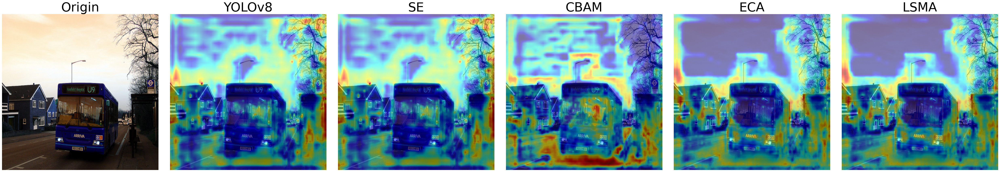


0: 640x640 1 person, 1 truck, 40.0ms
Speed: 5.0ms preprocess, 40.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 person, 1 truck, 32.0ms
Speed: 4.0ms preprocess, 32.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 person, 1 truck, 32.0ms
Speed: 3.0ms preprocess, 32.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 person, 1 truck, 33.0ms
Speed: 4.0ms preprocess, 33.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 2 persons, 1 car, 1 truck, 36.0ms
Speed: 4.0ms preprocess, 36.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 2 persons, 1 car, 1 truck, 47.0ms
Speed: 4.0ms preprocess, 47.0ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 person, 1 truck, 1 fire hydrant, 40.0ms
Speed: 3.0ms preprocess, 40.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 person, 1

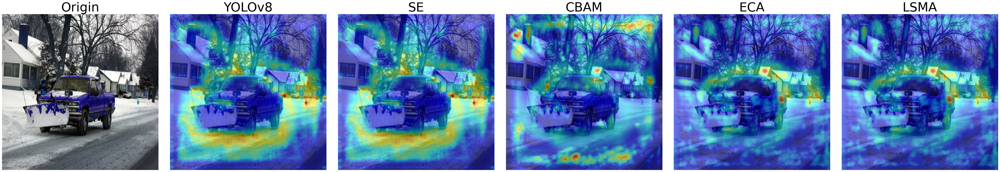


0: 640x640 1 person, 2 surfboards, 33.6ms
Speed: 4.0ms preprocess, 33.6ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 person, 2 surfboards, 34.0ms
Speed: 3.0ms preprocess, 34.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 person, 2 surfboards, 36.0ms
Speed: 4.0ms preprocess, 36.0ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 person, 2 surfboards, 32.0ms
Speed: 4.0ms preprocess, 32.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 person, 1 surfboard, 50.7ms
Speed: 4.0ms preprocess, 50.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 person, 1 surfboard, 41.0ms
Speed: 4.0ms preprocess, 41.0ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 person, 1 surfboard, 39.0ms
Speed: 4.0ms preprocess, 39.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 person, 1

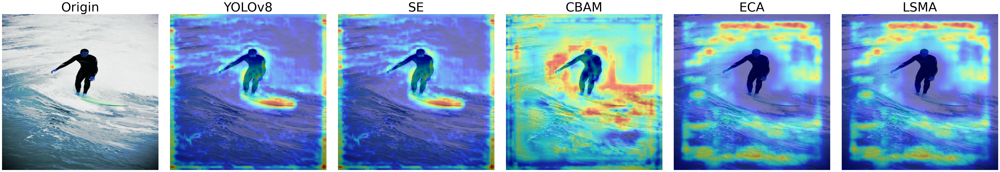


0: 640x640 3 persons, 1 snowboard, 32.0ms
Speed: 5.0ms preprocess, 32.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 3 persons, 1 snowboard, 31.0ms
Speed: 4.0ms preprocess, 31.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 3 persons, 1 snowboard, 32.0ms
Speed: 3.0ms preprocess, 32.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 3 persons, 1 snowboard, 31.0ms
Speed: 4.0ms preprocess, 31.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 3 persons, 1 snowboard, 37.0ms
Speed: 3.0ms preprocess, 37.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 3 persons, 1 snowboard, 36.0ms
Speed: 4.0ms preprocess, 36.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 3 persons, 1 snowboard, 36.0ms
Speed: 3.0ms preprocess, 36.0ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 3 person

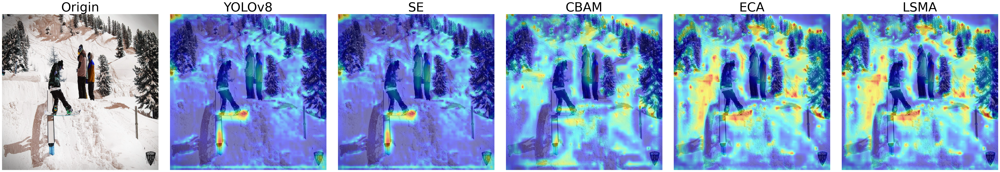


0: 640x640 7 persons, 1 sports ball, 33.0ms
Speed: 4.0ms preprocess, 33.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 7 persons, 1 sports ball, 43.0ms
Speed: 4.0ms preprocess, 43.0ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 7 persons, 1 sports ball, 38.0ms
Speed: 4.0ms preprocess, 38.0ms inference, 4.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 7 persons, 1 sports ball, 32.0ms
Speed: 5.0ms preprocess, 32.0ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 8 persons, 1 sports ball, 39.0ms
Speed: 3.0ms preprocess, 39.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 8 persons, 1 sports ball, 38.7ms
Speed: 3.0ms preprocess, 38.7ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 9 persons, 1 sports ball, 40.0ms
Speed: 4.0ms preprocess, 40.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

0: 64

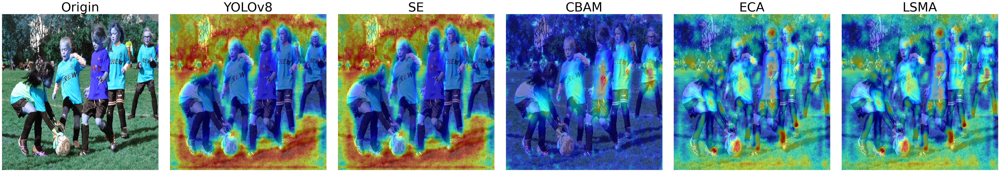


0: 640x640 2 persons, 1 sports ball, 34.0ms
Speed: 4.0ms preprocess, 34.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 2 persons, 1 sports ball, 33.0ms
Speed: 4.0ms preprocess, 33.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 2 persons, 1 sports ball, 32.0ms
Speed: 5.0ms preprocess, 32.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 2 persons, 1 sports ball, 32.0ms
Speed: 4.0ms preprocess, 32.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 2 persons, 1 sports ball, 40.0ms
Speed: 4.0ms preprocess, 40.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 2 persons, 1 sports ball, 41.0ms
Speed: 4.0ms preprocess, 41.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 2 persons, 1 sports ball, 38.0ms
Speed: 4.0ms preprocess, 38.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)

0: 64

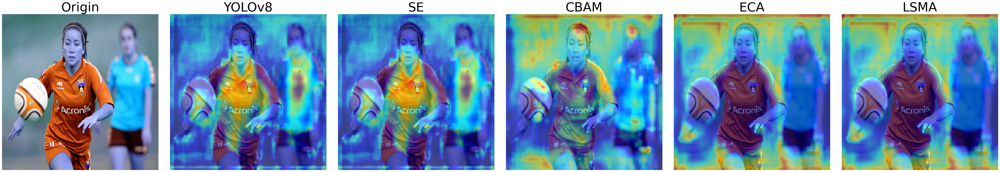

In [11]:
for image_file in image_files:
    image_path = os.path.join(image_folder, image_file)
    img = cv2.imread(image_path)
    img = cv2.resize(img, (640, 640))
    rgb_img = img.copy()
    img = np.float32(img) / 255
    images=[]
    images.append(img)
    grad(images)
    fig, axs = plt.subplots(nrows=1, ncols=6, figsize=(50, 50))
    plt.tight_layout()
    plt.subplots_adjust(hspace=0) 
    # 遍历子图并显示图像
    for ax, title, image in zip(axs, titles, images):
        ax.set_title(title,fontsize=45)
        ax.imshow(image)
        ax.axis('off')  # 关闭坐标轴
    plt.savefig("high_res_plot.png", dpi=300, transparent=True)
    plt.show()